In [247]:
# set up libraries + backend
from qiskit.tools.jupyter import * 
from qiskit import IBMQ
from qiskit import assemble
import numpy as np
import matplotlib.pyplot as plt
from qiskit import pulse
from qiskit.pulse import pulse_lib
from qiskit.pulse import Play
from qiskit.tools.monitor import job_monitor
from scipy.optimize import curve_fit
from scipy.interpolate import splrep, sproot, splev

%config InlineBackend.figure_format = 'svg' # cleans up backend

IBMQ.load_account()
provider = IBMQ.get_provider(hub='ibm-q', group='open', project='main')
backend = provider.get_backend('ibmq_armonk')

backend_config = backend.configuration()
assert backend_config.open_pulse, "Backend doesn't support OpenPulse"

# conversion factors
GHz = 1.0e9 
MHz = 1.0e6
us = 1.0e-6
ns = 1.0e-9 
scale_factor = 1e-14 

qubit = 0 # ground state qubit
dt = backend_config.dt # backend time-step

backend_defaults = backend.defaults()
qubit_props_dict = backend.properties().qubit_property(0)

# assign measurement map
meas_map_idx = None
for i, measure_group in enumerate(backend_config.meas_map):
    if qubit in measure_group:
        meas_map_idx = i
        break
assert meas_map_idx is not None, f"Couldn't find qubit {qubit} in the meas_map!"
qubit_meas_group = backend_config.meas_map[meas_map_idx]
inst_sched_map = backend_defaults.instruction_schedule_map
measure = inst_sched_map.get('measure', qubits=qubit_meas_group)

# assign experiment channels
drive_chan = pulse.DriveChannel(qubit)
meas_chan = pulse.MeasureChannel(qubit)
acq_chan = pulse.AcquireChannel(qubit)

# define for convenience
def get_closest_multiple_of_16(num):
    return int(num + 8 ) - (int(num + 8 ) % 16)

# Save and retrieve data from external text files
def save_data(dataset, file):
    filehandler = open(file, 'w')
    json.dump(dataset, filehandler)
    filehandler.close()

def load_data(file):
    filehandler = open(file)
    dataset = json.load(filehandler)
    filehandler.close()
    return dataset

ibmqfactory.load_account:WARNING:2020-07-15 15:42:42,222: Credentials are already in use. The existing account in the session will be replaced.


In [248]:
# Define measurement, acquisition, cavity parameters
cav_amp = 0.3 # large amplitude
meas_amp = 0.3
acq_samp_us = 0.2
meas_sigma_us = 0.01
meas_risefall_us = 0.01

acq_samp = get_closest_multiple_of_16(acq_samp_us * us/dt)
meas_sigma = get_closest_multiple_of_16(meas_sigma_us * us/dt)
meas_risefall = get_closest_multiple_of_16(meas_risefall_us * us/dt)
meas_pulse = pulse_lib.gaussian_square(duration=acq_samp, amp=meas_amp, sigma=meas_sigma, risefall=meas_risefall)

# Make measurement schedule
meas_schedule = pulse.Schedule(name="Measurement")
meas_schedule += Play(meas_pulse, meas_chan)
meas_schedule += pulse.Acquire(duration=acq_samp, 
                               channel=[pulse.AcquireChannel(i) for i in qubit_meas_group],
                               mem_slot=[pulse.MemorySlot(i) for i in qubit_meas_group])
acq_pulse = pulse.Acquire(duration=acq_samp, 
                               channel=[pulse.AcquireChannel(i) for i in qubit_meas_group],
                               mem_slot=[pulse.MemorySlot(i) for i in qubit_meas_group])

In [257]:
# Build frequency arrays
rough_cavity_freq = backend_defaults.meas_freq_est[qubit] # cavity freq from backend
num_samps = 40

freq_span = 1 * MHz # narrow window to isolate peak
freq_step = 0.0125 * MHz
freq_min = rough_cavity_freq - freq_span / 2
freq_max = rough_cavity_freq + freq_span / 2

# construct 2 freq sweeps per job (left and right halves)
freq_GHz_left = np.linspace(freq_min / GHz, rough_cavity_freq / GHz, num=num_samps, endpoint=False)
freq_GHz_right = np.linspace(rough_cavity_freq / GHz, freq_max / GHz, num=num_samps, endpoint=False)
freq_GHz_tot = np.concatenate((freq_GHz_left, freq_GHz_right))

freq_Hz_left = freq_GHz_left * GHz
freq_Hz_right = freq_GHz_right * GHz
freq_Hz_tot = freq_GHz_tot * GHz

array([6.99292785, 6.99294035, 6.99295285, 6.99296535, 6.99297785,
       6.99299035, 6.99300285, 6.99301535, 6.99302785, 6.99304035,
       6.99305286, 6.99306535, 6.99307786, 6.99309035, 6.99310286,
       6.99311535, 6.99312786, 6.99314035, 6.99315285, 6.99316535,
       6.99317785, 6.99319036, 6.99320285, 6.99321536, 6.99322785,
       6.99324036, 6.99325285, 6.99326536, 6.99327785, 6.99329036,
       6.99330285, 6.99331536, 6.99332786, 6.99334035, 6.99335286,
       6.99336535, 6.99337786, 6.99339035, 6.99340286, 6.99341535])

In [258]:
# Create schedule freqs
schedule_freq_left = [{meas_chan: freq} for freq in freq_Hz_left]
schedule_freq_right = [{meas_chan: freq} for freq in freq_Hz_right]

# Define cavity drive pulse
cavity_samp_us = 2.5
cavity_samp = get_closest_multiple_of_16(cavity_samp_us * us/dt)
cavity_pulse = pulse_lib.gaussian_square(duration=cavity_samp, amp=cav_amp, sigma=meas_sigma, risefall=meas_risefall)

In [259]:
# Design pi pulse
pi_data = load_data('pipulse.txt')
pi_amp = pi_data["pi_amp"] # from calibration experiment
drive_sigma_us = pi_data["drive_sigma_us"] # Width of the gaussian pulse
drive_samps_us = pi_data["drive_samps_us"] # Truncates duration of gaussian to be finite

drive_sigma = get_closest_multiple_of_16(drive_sigma_us * us /dt)       # Puts width in units of dt
drive_samps = get_closest_multiple_of_16(drive_samps_us * us /dt)   # Puts duration in units of dt

mod_pi_pulse = pulse_lib.gaussian(duration=drive_samps, amp=pi_amp, 
                              sigma=drive_sigma, name='pi_pulse') # build pulse based on amp found

In [260]:
# Total schedule for ground state qubit
master_schedule = pulse.Schedule(name="Total schedule")
master_schedule += Play(cavity_pulse, meas_chan) << drive_samples
master_schedule += meas_schedule 
num_shots = 1024

# Left and right programs
gnd_program_left = assemble(master_schedule, 
                  backend=backend,
                  meas_level=1,
                  meas_return='avg',
                  shots=num_shots,
                  schedule_los=schedule_freq_left)

gnd_program_right = assemble(master_schedule, 
                  backend=backend,
                  meas_level=1,
                  meas_return='avg',
                  shots=num_shots,
                  schedule_los=schedule_freq_right)

In [253]:
# Draw schedule to confirm
master_schedule.draw()

In [261]:
# Execute left and right jobs
gnd_job_left = backend.run(gnd_program_left)
print(f"Gnd left job is {gnd_job_left.job_id()}")
job_monitor(gnd_job_left)

gnd_job_right = backend.run(gnd_program_right)
print(f"Gnd right job is {gnd_job_right.job_id()}")
job_monitor(gnd_job_right)

Gnd left job is 5f0f5d073e5b6a001b4ff304
Job Status: job has successfully run
Gnd right job is 5f0f5e4f43a386001a1df820
Job Status: job has successfully run


In [255]:
# Check for errors
gnd_job_left.error_message()
gnd_job_right.error_message()

'Waveform memory exceeds the maximum amount of memory currently available. Error code: 8018.'

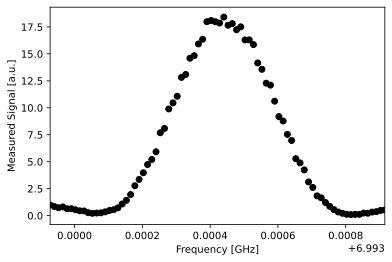

In [262]:
# Extract results, place both halves into one array
gnd_results_left = gnd_job_left.result(timeout=120)
gnd_sweep = []
for i in range (len(gnd_results_left.results)):
    res = gnd_results_left.get_memory(i)*scale_factor
    norm_res = np.real(res[qubit]*np.conjugate(res[qubit]))
    gnd_sweep.append(norm_res)
    
gnd_results_right = gnd_job_right.result(timeout=120)
for i in range (len(gnd_results_right.results)):
    res = gnd_results_right.get_memory(i)*scale_factor
    norm_res = np.real(res[qubit]*np.conjugate(res[qubit]))
    gnd_sweep.append(norm_res)

# Show results from both halves together for gnd state
plt.scatter(freq_GHz_tot, gnd_sweep, color='black')
plt.xlim([min(freq_GHz_tot), max(freq_GHz_tot)])
plt.xlabel("Frequency [GHz]")
plt.ylabel("Measured Signal [a.u.]")
plt.title("Total gnd state freq sweep")
plt.show()

In [ ]:
# Define curve fitting function, allow for large number of max calls due to variety of plots from jobs
def fit_function(x_values, y_values, function, init_params):
    fitparams, conv = curve_fit(function, x_values, y_values, init_params, maxfev=5000) 
    y_fit = function(x_values, *fitparams)
    return fitparams, y_fit

In [265]:
# Fit total data
ground_params, ground_fit = fit_function(freq_GHz_tot, gnd_sweep, 
         lambda x, A, mod_qubit_freq, B, C: (A / np.pi) * (B / ((x - mod_qubit_freq)**2 + B**2)) + C,
        [4, 6.9934, 1, 3]) # initial parameters for curve_fit
_, grd_freq, _, _ = ground_params

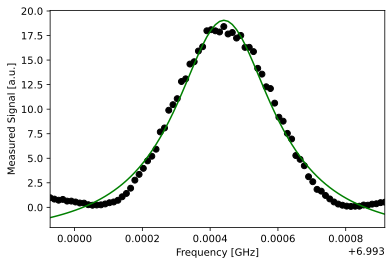

In [266]:
# Check curve fit
plt.scatter(freq_GHz_tot, gnd_sweep, color='black')
plt.plot(freq_GHz_tot, ground_fit, color='green')
plt.xlim([min(freq_GHz_tot), max(freq_GHz_tot)])
plt.xlabel("Frequency [GHz]")
plt.ylabel("Measured Signal [a.u.]")
plt.title("Total gnd state freq sweep")
plt.show()

In [267]:
# Total schedule for excited state qubit 
master_schedule_1 = pulse.Schedule(name="Total schedule")
master_schedule_1 += Play(mod_pi_pulse, drive_chan)
master_schedule_1 += Play(cavity_pulse, meas_chan) << master_schedule_1.duration
master_schedule_1 += meas_schedule

# Left and right programs
exc_program_left = assemble(master_schedule_1, 
                  backend=backend,
                  meas_level=1,
                  meas_return='avg',
                  shots=num_shots,
                  schedule_los=schedule_freq_left)

exc_program_right = assemble(master_schedule_1, 
                  backend=backend,
                  meas_level=1,
                  meas_return='avg',
                  shots=num_shots,
                  schedule_los=schedule_freq_right)


In [219]:
# Draw exc schedule
master_schedule_1.draw()

In [270]:
# Execute jobs
exc_job_left = backend.run(exc_program_left)
print (exc_job_left.job_id())
job_monitor(exc_job_left)

exc_job_right = backend.run(exc_program_right)
print (exc_job_right.job_id())
job_monitor(exc_job_right)

5f0f6145b14a85001b9c19b7
Job Status: job has successfully run
5f0f625b8cfc23001a173f82
Job Status: job has successfully run


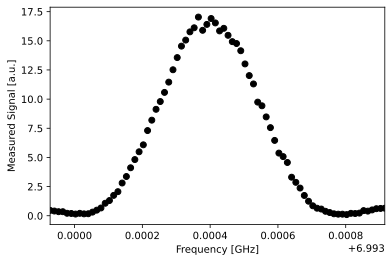

In [271]:
# Extract results
exc_sweep = []
exc_results_left = exc_job_left.result(timeout=120)
for i in range (len(exc_results_left.results)):
    res = exc_results_left.get_memory(i)*scale_factor
    norm_res = np.real(res[qubit]*np.conjugate(res[qubit]))
    exc_sweep.append(norm_res)
    
exc_results_right = exc_job_right.result(timeout=120)
for i in range (len(exc_results_right.results)):
    res = exc_results_right.get_memory(i)*scale_factor
    norm_res = np.real(res[qubit]*np.conjugate(res[qubit]))
    exc_sweep.append(norm_res)
    
plt.scatter(freq_GHz_tot, exc_sweep, color='black')
plt.xlim([min(freq_GHz_tot), max(freq_GHz_tot)])
plt.xlabel("Frequency [GHz]")
plt.ylabel("Measured Signal [a.u.]")
plt.title("Total exc state freq sweep")
plt.show()

In [295]:
# Fit total exc data
excited_params, excited_fit = fit_function(freq_GHz_tot, exc_sweep,
         lambda x, A, mod_qubit_freq, B, C: (A / np.pi) * (B / ((x - mod_qubit_freq)**2 + B**2)) + C,
        [4, 6.993, 1, 3]) # initial parameters for curve_fit
_, exc_freq, B, _ = excited_params

In [297]:
B * GHz / MHz

0.17874376632837416

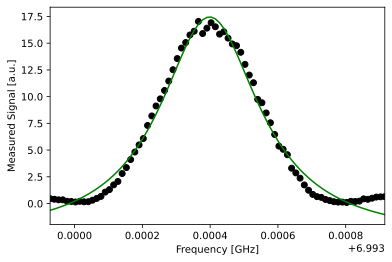

In [276]:
# Check curve
plt.scatter(freq_GHz_tot, exc_sweep, color='black')
plt.plot(freq_GHz_tot, excited_fit, color='green')
plt.xlim([min(freq_GHz_tot), max(freq_GHz_tot)])
plt.xlabel("Frequency [GHz]")
plt.ylabel("Measured Signal [a.u.]")
plt.title("Total exc state freq sweep")
plt.show()

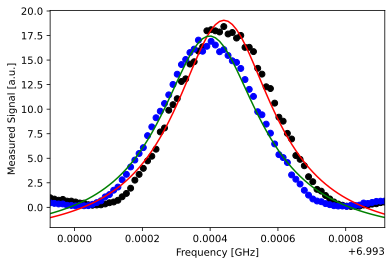

In [278]:
# Plot and compare together
plt.scatter(freq_GHz_tot, gnd_sweep, color='black')
plt.plot(freq_GHz_tot, ground_fit, color='red')
plt.scatter(freq_GHz_tot, exc_sweep, color='blue')
plt.plot(freq_GHz_tot, excited_fit, color='green')
plt.xlim([min(freq_GHz_tot), max(freq_GHz_tot)])
plt.xlabel("Frequency [GHz]")
plt.ylabel("Measured Signal [a.u.]")
plt.title("Gnd and exc sweeps together"})
plt.show()

In [279]:
grd_freq_Hz = grd_freq * GHz
exc_freq_Hz = exc_freq * GHz

# We know wc_e = wc - X, wc_g = wc + X --> wc = (wc_g + wc_e) / 2 and X = (wc_g - wc_e) / 2
cav_freq_Hz = (grd_freq_Hz + exc_freq_Hz) / 2
X_Hz = (grd_freq_Hz - exc_freq_Hz) / 2

In [282]:
print(f"Cavity frequency is {cav_freq_Hz / GHz} GHz")
print(f"Dispersion is {X_Hz / GHz} GHz")

Cavity frequency is 6.993419623685421 GHz
Dispersion is 2.1095807532310484e-05 GHz


In [292]:
# Now we can get linewidth for gnd state 

# Define function that retrieves fwhwm
from scipy.interpolate import splrep, sproot, splev

def fwhm(indep, data):
    half_max = max(data)/2.0
    s = splrep(indep, data - half_max)
    roots = sproot(s)
    return (abs(roots[1]-roots[0])), roots[0], roots[1], half_max

kappa, lhs, rhs, half_max = fwhm(freq_GHz_tot, ground_fit)

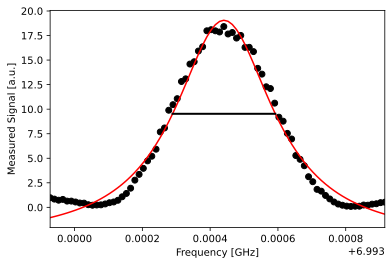

In [293]:
# Plot linewidth to verify
plt.scatter(freq_GHz_tot, gnd_sweep, color='black')
plt.plot(freq_GHz_tot, ground_fit, color='red')
plt.xlim([min(freq_GHz_tot), max(freq_GHz_tot)])
plt.xlabel("Frequency [GHz]")
plt.ylabel("Measured Signal [a.u.]")
plt.plot([lhs, rhs], [half_max, half_max], color='k', linestyle='-', linewidth=2, label='kappa')
plt.title("Gnd state linewidth")
plt.show()

In [294]:
kappa_Hz = kappa * GHz
print(f"Linewidth is {kappa_Hz / MHz} MHz")

Linewidth is 0.3030814301627771 MHz


In [1]:
GHz = 1.0e9 
MHz = 1.0e6

wc_Hz = 6.993419623685421 * GHz
X_Hz = 2.1095807532310484e-05 * GHz
kappa_Hz = 0.3030814301627771 * MHz
this_data = {'wc': wc_Hz, 'X': X_Hz, 'kappa': kappa_Hz, 'meas_amp': 0.3, 'cav_amp': 0.3}

import json 
filehandler = open('CavityParameters.txt', 'w')
json.dump(this_data, filehandler)
filehandler.close()